In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from skimage import io, filters, measure, morphology, restoration, segmentation, util
from scipy import ndimage, stats
import seaborn as sns
import pandas as pd
import tifffile

In [2]:
#navigate to folder containing data of interest
homedir = os.getcwd() #get starting directory
data_loc = '/Volumes/Shared/Pure1300/Users/chernandezcandia/12152023-Tz/2hr +SA/'
os.chdir(data_loc) 

In [3]:
#read in no drug controls
nodrug_FOV_1 = tifffile.imread('no drug/200uM SA-2h-no drug-RPE1wt-470-650-405nm/200uM SA-2h-no drug-RPE1wt-470-650-405nm_MMStack_Pos0.ome.tif')
nodrug_FOV_2 = tifffile.imread('no drug/200uM SA-2h-no drug-RPE1wt-470-640-405-2/200uM SA-2h-no drug-RPE1wt-470-640-405-2_MMStack_Pos0.ome.tif')
nodrug_FOV_3 = tifffile.imread('no drug/200uM SA-2h-no drug-RPE1wt-470-640-405-3/200uM SA-2h-no drug-RPE1wt-470-640-405-3_MMStack_Pos0.ome.tif')

In [4]:
#check data size
np.shape(nodrug_FOV_1)

(3, 2720, 2720)

In [5]:
#this represents num channels (N) x X x Y
#channel 0 = G3BP1, channel 1 = SQSTM1, and channel 2 = nuclei

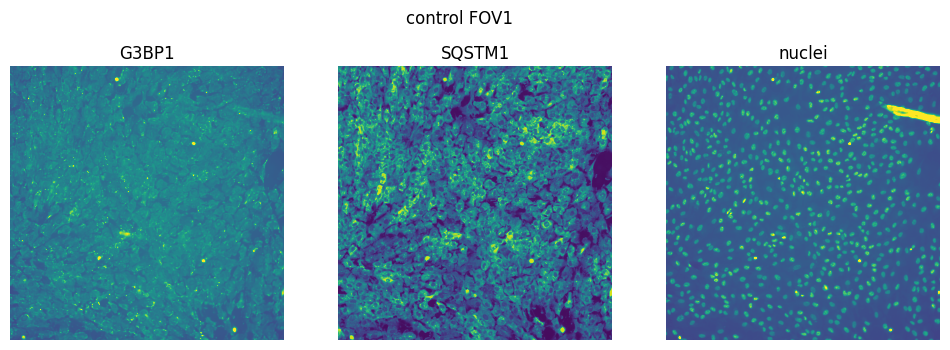

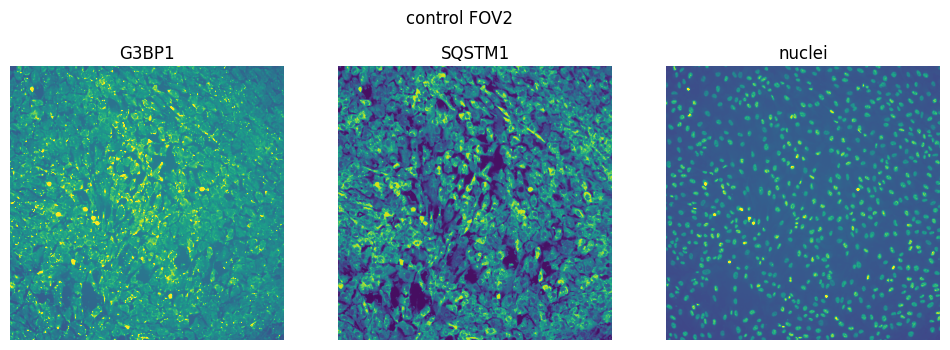

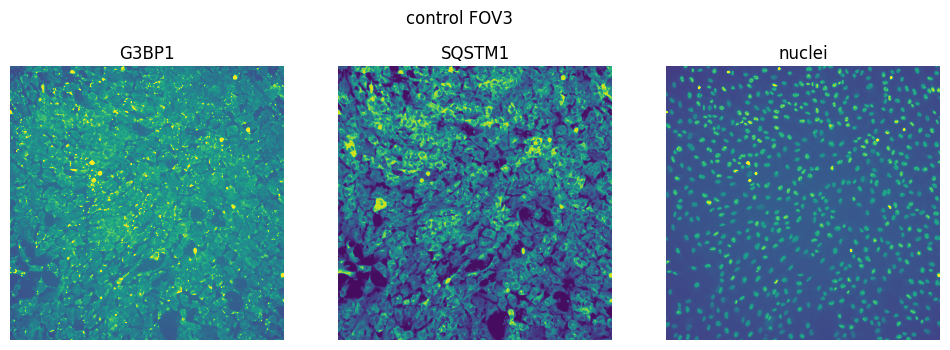

In [6]:
#let's look at all three control fields of view, all channels

def plot_allchannels(multichannelim, desired_title, channel_names, cmax):
    #mutichannelim is an NxXxY image
    #desired_title is a string that will title the image 
    #channel_names is a list of names for each channel (length should be equal to N)
    #cmax is a list of max intensity value for each channel (length should be equal to N)
    plt.figure(figsize = (12,4))
    for i in range(len(channel_names)):
        plt.suptitle(desired_title)
        plt.subplot(1,len(channel_names),i+1)
        plt.title(channel_names[i])
        plt.imshow(multichannelim[i])
        plt.clim([0,cmax[i]]) #changed color scaling so we can see better
        plt.axis('off')

#define some of the shared arguments that are used in above function
channels = ['G3BP1', 'SQSTM1', 'nuclei']
cmax_vals = [15000, 70000, 20000]

#display data using the above function
plot_allchannels(nodrug_FOV_1, 'control FOV1', channels, cmax_vals)
plot_allchannels(nodrug_FOV_2, 'control FOV2', channels, cmax_vals)
plot_allchannels(nodrug_FOV_3, 'control FOV3', channels, cmax_vals)

In [7]:
#Let's repeat the above with our datasets of interest
Tz_FOV_1 = tifffile.imread('Tz/200uM SA-2h-1uM Tz_ON-RPE1wt- 470-640-405nm/200uM SA-2h-1uM Tz_ON-RPE1wt- 470-640-405nm_MMStack_Pos0.ome.tif')
Tz_FOV_2 = tifffile.imread('Tz/200uM SA-2h-Tz_ON-RPE1wt-470-640-405nm-2/200uM SA-2h-Tz_ON-RPE1wt-470-640-405nm-2_MMStack_Pos0.ome.tif')
Tz_FOV_3 = tifffile.imread('Tz/200uM SA-2h-Tz_ON-RPE1wt-470-640-405-3/200uM SA-2h-Tz_ON-RPE1wt-470-640-405-3_MMStack_Pos0.ome.tif')

TzNC_FOV_1 = tifffile.imread('Tz-n2c/200uM SA-2h-1uM Tz-n2c_ON-RPE1wt-470-650-405nm/200uM SA-2h-1uM Tz-n2c_ON-RPE1wt-470-650-405nm_MMStack_Pos0.ome.tif')
TzNC_FOV_2 = tifffile.imread('Tz-n2c/200uM SA-2h-Tz-n2c-RPE1wt-470-640-405nm-2/200uM SA-2h-Tz-n2c-RPE1wt-470-640-405nm-2_MMStack_Pos0.ome.tif')
TzNC_FOV_3 = tifffile.imread('Tz-n2c/200uM SA-2h-Tz-n2c-RPE1wt-470-640-405-3/200uM SA-2h-Tz-n2c-RPE1wt-470-640-405-3_MMStack_Pos0.ome.tif')

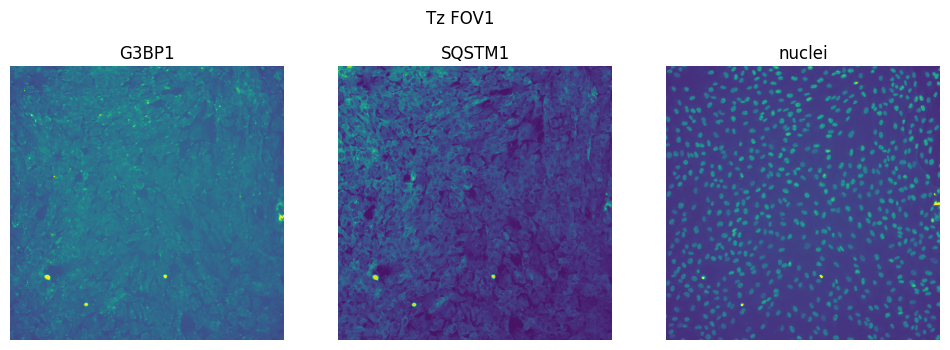

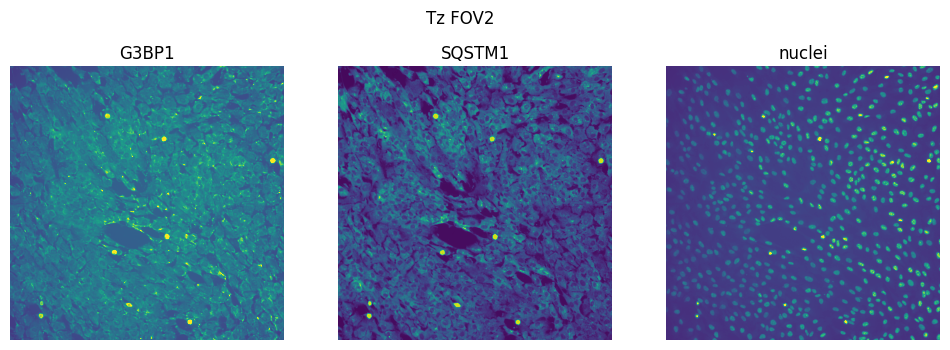

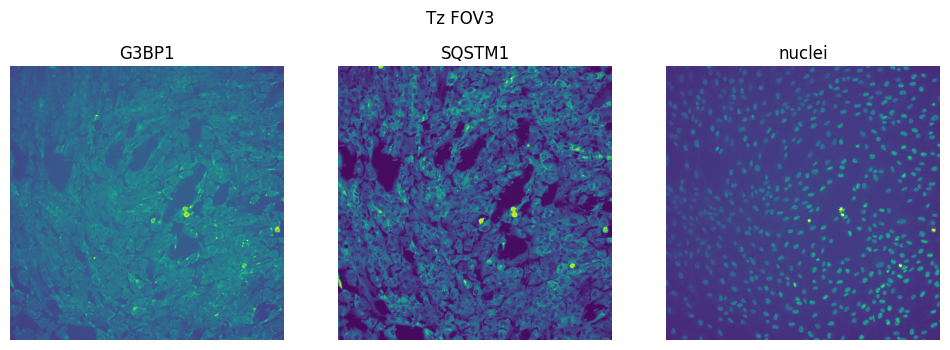

In [8]:
#let's use the same function we wrote above to see data sets
plot_allchannels(Tz_FOV_1, 'Tz FOV1', channels, cmax_vals)
plot_allchannels(Tz_FOV_2, 'Tz FOV2', channels, cmax_vals)
plot_allchannels(Tz_FOV_3, 'Tz FOV3', channels, cmax_vals)

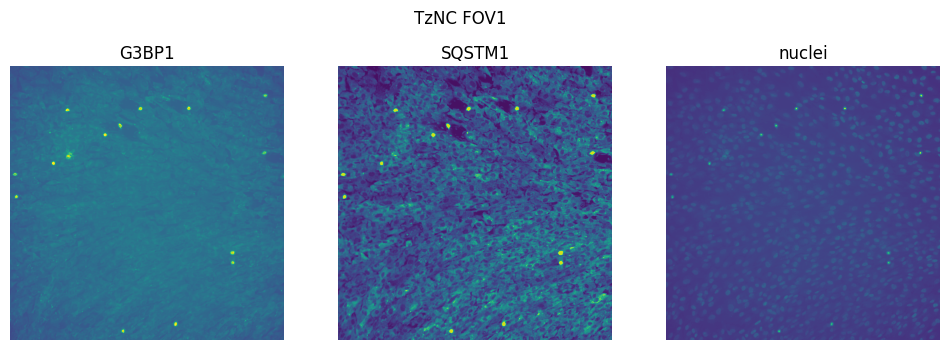

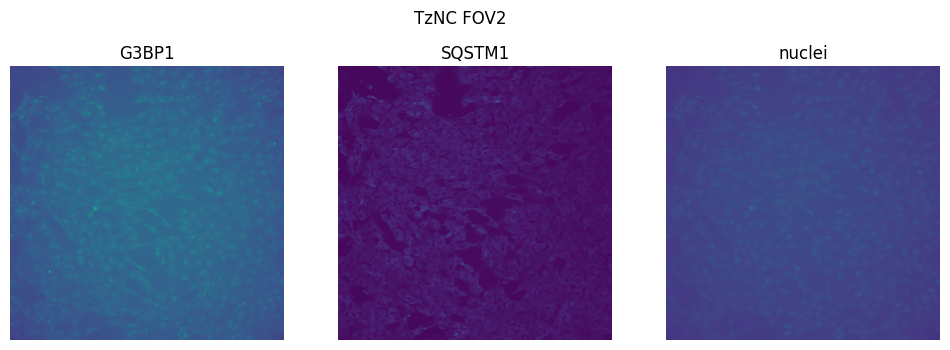

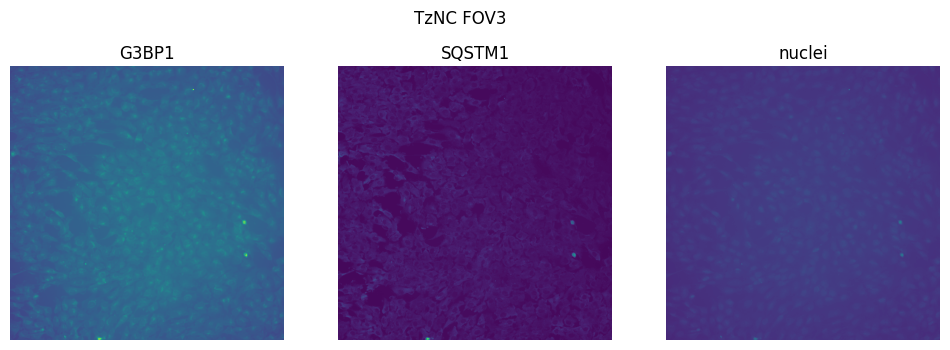

In [9]:
#let's use the same function we wrote above to see data sets
plot_allchannels(TzNC_FOV_1, 'TzNC FOV1', channels, cmax_vals)
plot_allchannels(TzNC_FOV_2, 'TzNC FOV2', channels, cmax_vals)
plot_allchannels(TzNC_FOV_3, 'TzNC FOV3', channels, cmax_vals)

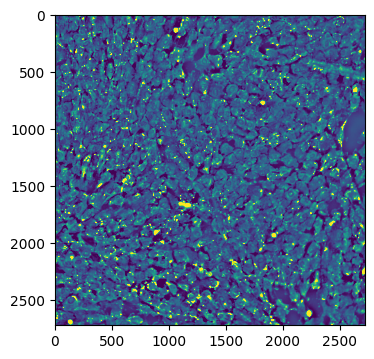

In [10]:
#flat field correction
#added this in because pretty bad vignetting in Tz N2C data
sigma_FF = 50
nodrug_FOV_1_G3BP1_FF = filters.difference_of_gaussians(nodrug_FOV_1[0],1,sigma_FF)
nodrug_FOV_2_G3BP1_FF = filters.difference_of_gaussians(nodrug_FOV_2[0],1,sigma_FF)
nodrug_FOV_3_G3BP1_FF = filters.difference_of_gaussians(nodrug_FOV_3[0],1,sigma_FF)

#check FOV
plt.figure(figsize = (4,8))
plt.imshow(nodrug_FOV_1_G3BP1_FF, clim = [-0.02,0.05])


In [11]:
#We want to use intensity of control channels to threshold
#let's first normalize each because of potential differences in intensity
nodrug_FOV_1_G3BP1_norm = nodrug_FOV_1_G3BP1_FF/np.max(nodrug_FOV_1_G3BP1_FF)
nodrug_FOV_2_G3BP1_norm = nodrug_FOV_2_G3BP1_FF/np.max(nodrug_FOV_2_G3BP1_FF)
nodrug_FOV_3_G3BP1_norm = nodrug_FOV_3_G3BP1_FF/np.max(nodrug_FOV_3_G3BP1_FF)

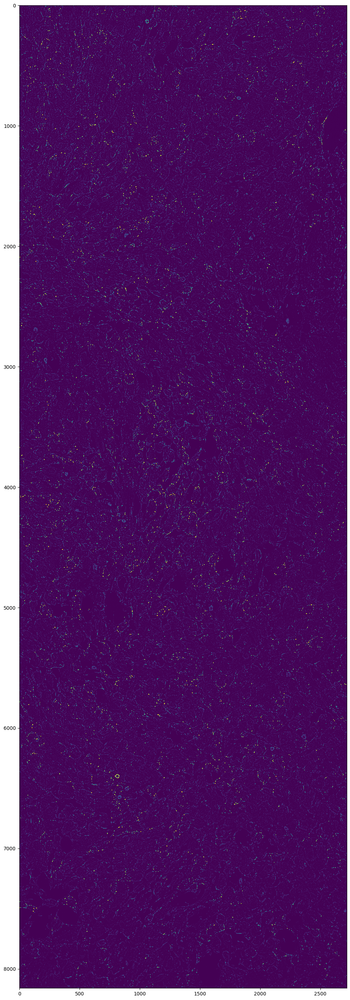

In [12]:
#get background subtracted images by taking a difference of gaussians 
#sigma_high = 2 and sigma_low = 1 is good for finding edges 
nodrug_FOV_1_G3BP1_norm_bkgdsub = filters.difference_of_gaussians(nodrug_FOV_1_G3BP1_norm, 1, 2)
nodrug_FOV_2_G3BP1_norm_bkgdsub = filters.difference_of_gaussians(nodrug_FOV_2_G3BP1_norm, 1, 2)
nodrug_FOV_3_G3BP1_norm_bkgdsub = filters.difference_of_gaussians(nodrug_FOV_3_G3BP1_norm, 1, 2)

#display the background subtracted images. Here we have just stacked all three FOVs
nodrug_G3BP1_norm_bkgdsub = np.concatenate([nodrug_FOV_1_G3BP1_norm_bkgdsub,nodrug_FOV_2_G3BP1_norm_bkgdsub,nodrug_FOV_3_G3BP1_norm_bkgdsub], axis = 0)
plt.figure(figsize = (12,40))
plt.imshow(nodrug_G3BP1_norm_bkgdsub, clim = [0,0.05])

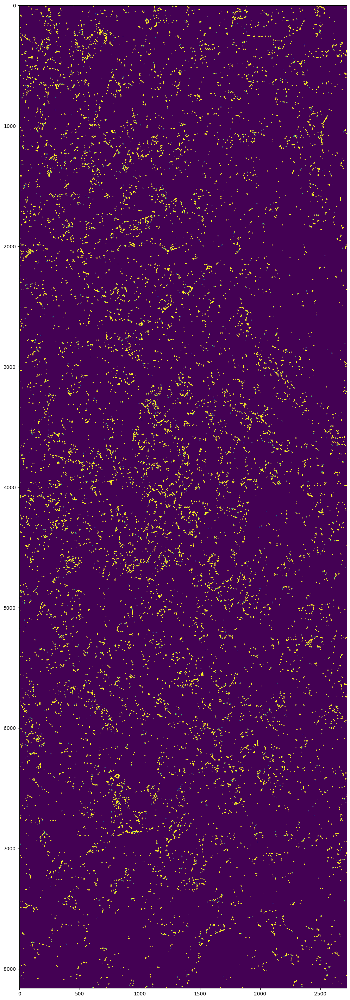

In [13]:
#filter out anything below image foreground/background threshold
thresh = filters.threshold_otsu(nodrug_G3BP1_norm_bkgdsub)

#binarize each FOV using the threshold
threshold_val = 1*thresh
nodrug_FOV_1_G3BP1_bin = nodrug_FOV_1_G3BP1_norm_bkgdsub > threshold_val
nodrug_FOV_2_G3BP1_bin = nodrug_FOV_2_G3BP1_norm_bkgdsub > threshold_val
nodrug_FOV_3_G3BP1_bin = nodrug_FOV_3_G3BP1_norm_bkgdsub > threshold_val

#display concatenated image to assess performance
nodrug_G3BP1_bin = np.concatenate([nodrug_FOV_1_G3BP1_bin,nodrug_FOV_2_G3BP1_bin,nodrug_FOV_3_G3BP1_bin], axis = 0)
plt.figure(figsize = (12,40))
plt.imshow(nodrug_G3BP1_bin, clim = [0,0.01])


(300.0, 600.0)

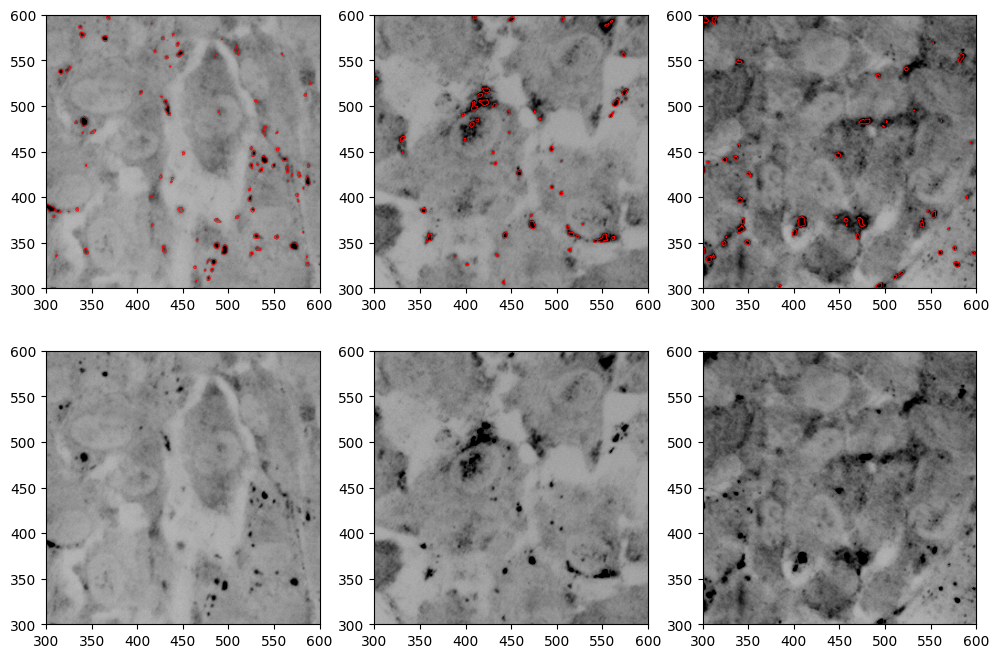

In [14]:
#Let's see how we did by plotting contours of isolated binary features over original image
#find_countours is a built in that finds outline of images in binary map
contours_1 = measure.find_contours(nodrug_FOV_1_G3BP1_bin)
contours_2 = measure.find_contours(nodrug_FOV_2_G3BP1_bin)
contours_3 = measure.find_contours(nodrug_FOV_3_G3BP1_bin)


#Here we are plotting zoomed in regions of each G3BP1 channel with overlaid contours and their raw image below
xmin, xmax, ymin, ymax = 300, 600, 300, 600

plt.figure(figsize = (12,8))
ax = plt.subplot(2,3,1)
plt.imshow(nodrug_FOV_1[0], cmap = 'gray_r', clim = [0,15000])
for contour in contours_1:
    ax.plot(contour[:, 1], contour[:, 0], linewidth=0.5, color = 'r')
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])

ax = plt.subplot(2,3,2)
plt.imshow(nodrug_FOV_2[0], cmap = 'gray_r', clim = [0,15000])
for contour in contours_2:
    ax.plot(contour[:, 1], contour[:, 0], linewidth=0.7, color = 'r')
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])

ax = plt.subplot(2,3,3)
plt.imshow(nodrug_FOV_3[0], cmap = 'gray_r', clim = [0,15000])
for contour in contours_3:
    ax.plot(contour[:, 1], contour[:, 0], linewidth=0.7, color = 'r')
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])

ax = plt.subplot(2,3,4)
plt.imshow(nodrug_FOV_1[0], cmap = 'gray_r', clim = [0,15000])
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])

ax = plt.subplot(2,3,5)
plt.imshow(nodrug_FOV_2[0], cmap = 'gray_r', clim = [0,15000])
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])

ax = plt.subplot(2,3,6)
plt.imshow(nodrug_FOV_3[0], cmap = 'gray_r', clim = [0,15000])
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])

(300.0, 600.0)

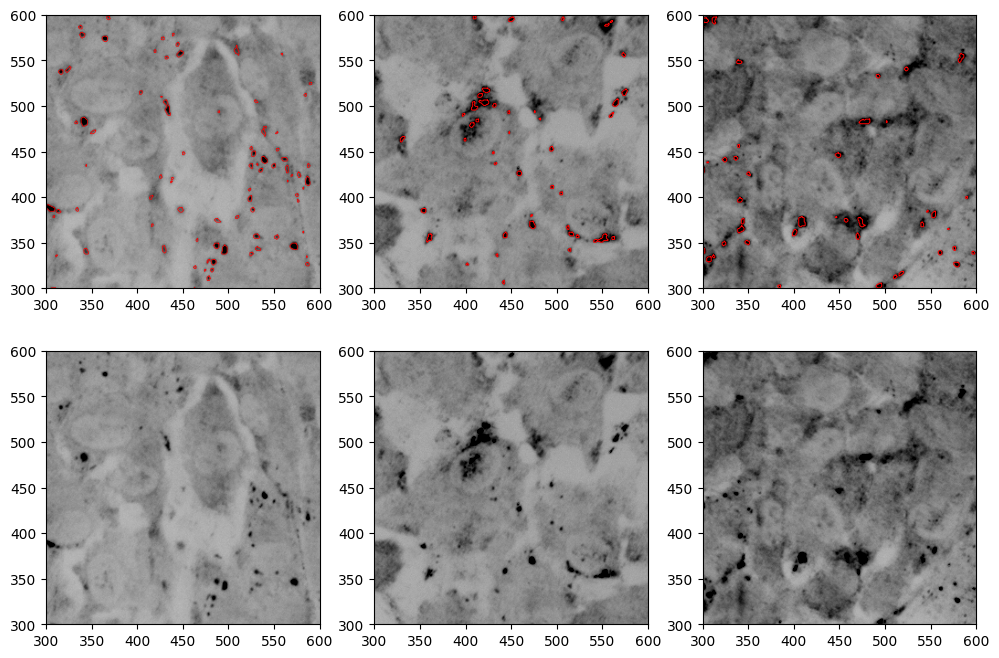

In [15]:
#We can also filter our contours to get rid of anything too large or too small
#It doesn't really make a difference here but nice to have
minPunctaSize, maxPunctaSize = 10, 300
contours_1_filt = [x for x in contours_1 if x.size < maxPunctaSize and x.size > minPunctaSize]
contours_2_filt = [x for x in contours_2 if x.size < maxPunctaSize and x.size > minPunctaSize]
contours_3_filt = [x for x in contours_3 if x.size < maxPunctaSize and x.size > minPunctaSize]


#Here we are plotting zoomed in regions of each G3BP1 channel with overlaid contours

xmin, xmax, ymin, ymax = 300, 600, 300, 600

plt.figure(figsize = (12,8))
ax = plt.subplot(2,3,1)
plt.imshow(nodrug_FOV_1[0], cmap = 'gray_r', clim = [0,15000])
for contour in contours_1_filt:
    ax.plot(contour[:, 1], contour[:, 0], linewidth=0.5, color = 'r')
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])

ax = plt.subplot(2,3,2)
plt.imshow(nodrug_FOV_2[0], cmap = 'gray_r', clim = [0,15000])
for contour in contours_2_filt:
    ax.plot(contour[:, 1], contour[:, 0], linewidth=0.7, color = 'r')
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])

ax = plt.subplot(2,3,3)
plt.imshow(nodrug_FOV_3[0], cmap = 'gray_r', clim = [0,15000])
for contour in contours_3_filt:
    ax.plot(contour[:, 1], contour[:, 0], linewidth=0.7, color = 'r')
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])

ax = plt.subplot(2,3,4)
plt.imshow(nodrug_FOV_1[0], cmap = 'gray_r', clim = [0,15000])
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])

ax = plt.subplot(2,3,5)
plt.imshow(nodrug_FOV_2[0], cmap = 'gray_r', clim = [0,15000])
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])

ax = plt.subplot(2,3,6)
plt.imshow(nodrug_FOV_3[0], cmap = 'gray_r', clim = [0,15000])
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])

In [16]:
#Obviously this is not perfect but qualitatively we are identifying local maxima with the same threshold 
#Note our decision to remove counting any puncta in the nucleus
#We can make our classification stricter or more relaxed by scaling the threshold value we supplied when we binarized.
#i.e. here we used by using 0.8*thresh (or 80% of the returned Otsu threshold)

(0.0, 500.0)

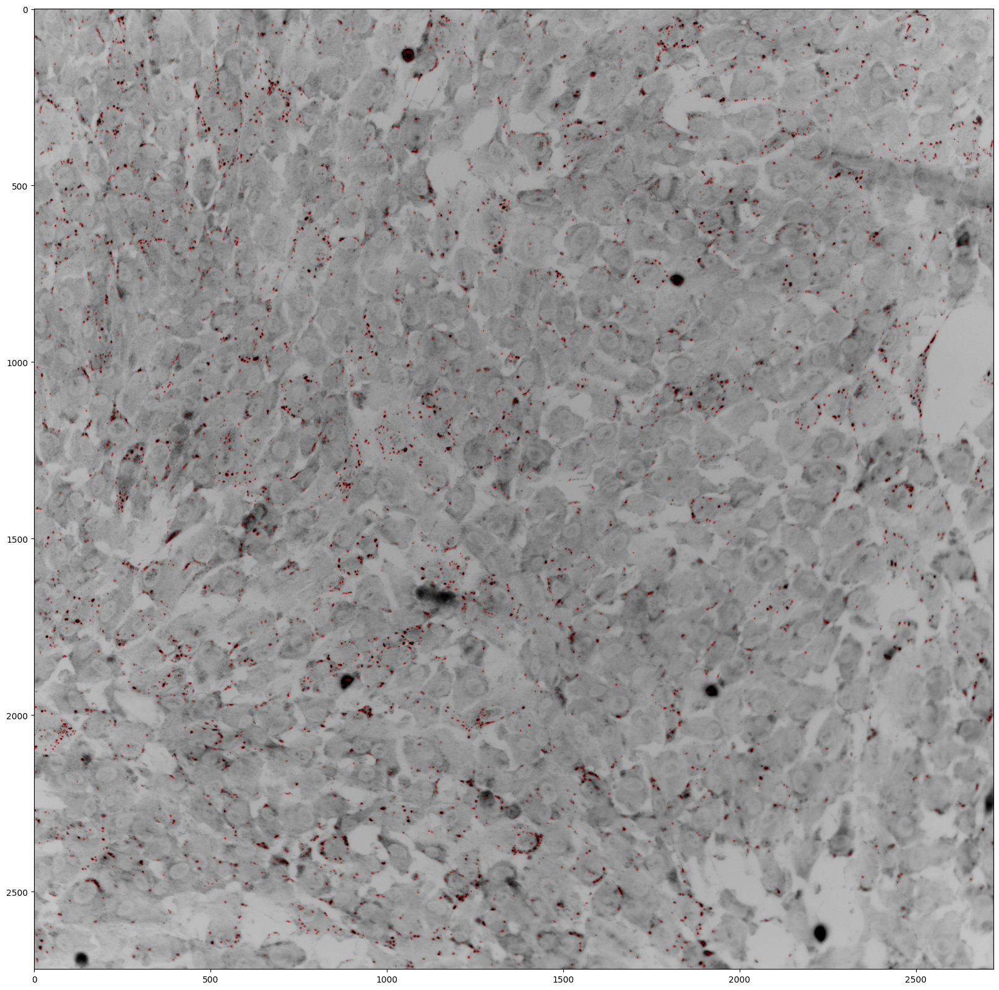

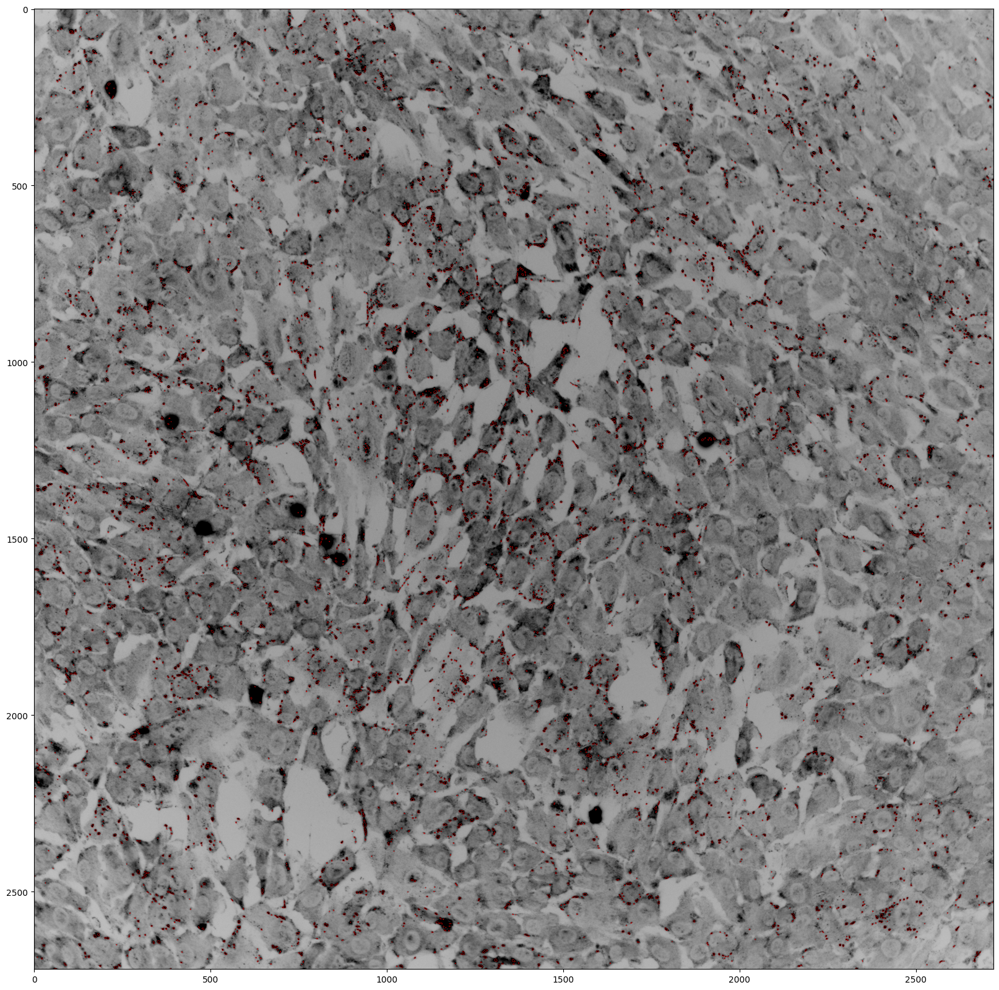

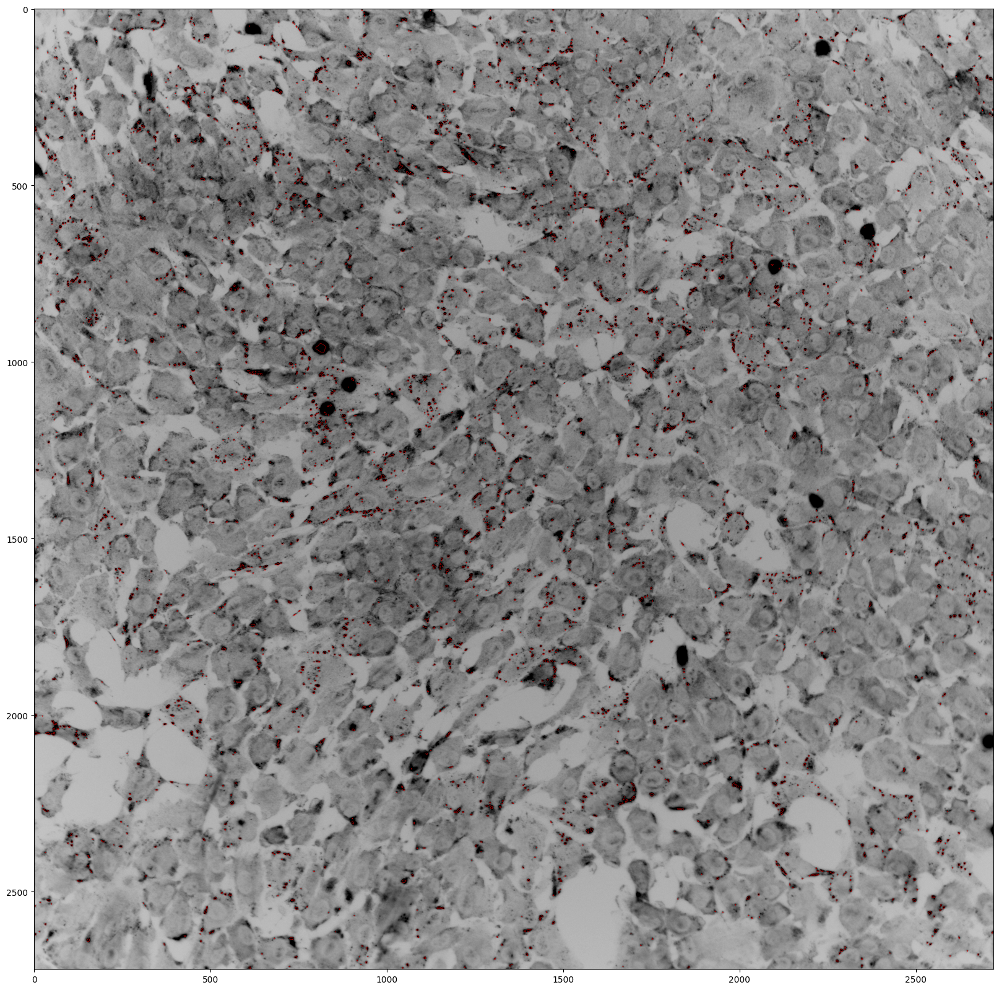

In [17]:
#Let's look at a larger portion of the FOVs in greater detail
plt.figure(figsize = (20,30))
plt.imshow(nodrug_FOV_1[0], cmap = 'gray_r', clim = [0,15000])
for contour in contours_1_filt:
    plt.gca().plot(contour[:, 1], contour[:, 0], linewidth=0.3, color = 'r')
ax.set_xlim([0,500])
ax.set_ylim([0,500])

plt.figure(figsize = (20,30))
plt.imshow(nodrug_FOV_2[0], cmap = 'gray_r', clim = [0,15000])
for contour in contours_2_filt:
    plt.gca().plot(contour[:, 1], contour[:, 0], linewidth=0.3, color = 'r')
ax.set_xlim([0,500])
ax.set_ylim([0,500])

plt.figure(figsize = (20,30))
plt.imshow(nodrug_FOV_3[0], cmap = 'gray_r', clim = [0,15000])
for contour in contours_3_filt:
    plt.gca().plot(contour[:, 1], contour[:, 0], linewidth=0.3, color = 'r')
ax.set_xlim([0,500])
ax.set_ylim([0,500])

In [18]:
#How many puncta were in each FOV
print('puncta in FOV1 = ' + str(len(contours_1_filt)))
print('puncta in FOV2 = ' + str(len(contours_2_filt)))
print('puncta in FOV3 = ' + str(len(contours_3_filt)))


puncta in FOV1 = 3802
puncta in FOV2 = 4623
puncta in FOV3 = 3126


nuclei in FOV1 = 724
nuclei in FOV2 = 707
nuclei in FOV3 = 659


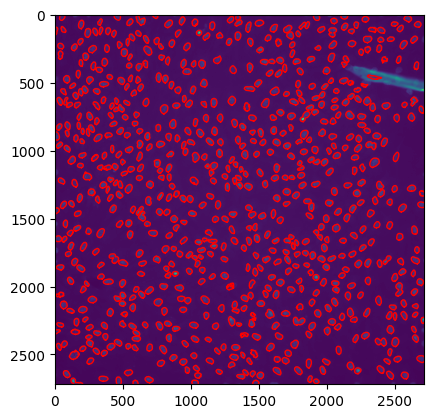

In [19]:
#We also can know the number of nuclei by making a binary mask
#Here is an example of getting number of items

#FF correct
nodrug_FOV_1_nuc_FF = filters.difference_of_gaussians(nodrug_FOV_1[2],1,sigma_FF)
nodrug_FOV_2_nuc_FF = filters.difference_of_gaussians(nodrug_FOV_2[2],1,sigma_FF)
nodrug_FOV_3_nuc_FF = filters.difference_of_gaussians(nodrug_FOV_3[2],1,sigma_FF)

#blur nuclear channel for smooth filtering
sigma = 1
nodrug_FOV_1_nuc = filters.gaussian(nodrug_FOV_1_nuc_FF, sigma)
nodrug_FOV_2_nuc = filters.gaussian(nodrug_FOV_2_nuc_FF, sigma)
nodrug_FOV_3_nuc = filters.gaussian(nodrug_FOV_3_nuc_FF, sigma)

#take values above threshold
nodrug_FOV_1_nuc_mask = nodrug_FOV_1_nuc > 0.8*filters.threshold_otsu(nodrug_FOV_1_nuc)
nodrug_FOV_2_nuc_mask = nodrug_FOV_2_nuc > 0.8*filters.threshold_otsu(nodrug_FOV_2_nuc)
nodrug_FOV_3_nuc_mask = nodrug_FOV_3_nuc > 0.8*filters.threshold_otsu(nodrug_FOV_3_nuc)

#find countours in binary
contours_nuc_1 = measure.find_contours(nodrug_FOV_1_nuc_mask)
nucmin, nucmax = 200, 2000
contours_nuc_1_filt = [x for x in contours_nuc_1 if x.size < nucmax and x.size > nucmin]

#plot example
plt.imshow(nodrug_FOV_1[2])
for contour in contours_nuc_1_filt:
    plt.gca().plot(contour[:, 1], contour[:, 0], linewidth=1, color = 'r')
print('nuclei in FOV1 = ' + str(len(contours_nuc_1_filt)))


#just print value for other FOVs
contours_nuc_2 = measure.find_contours(nodrug_FOV_2_nuc_mask)
contours_nuc_2_filt = [x for x in contours_nuc_2 if x.size < nucmax and x.size > nucmin]
print('nuclei in FOV2 = ' + str(len(contours_nuc_2_filt)))

contours_nuc_3 = measure.find_contours(nodrug_FOV_3_nuc_mask)
contours_nuc_3_filt = [x for x in contours_nuc_3 if x.size < nucmax and x.size > nucmin]
print('nuclei in FOV3 = ' + str(len(contours_nuc_3_filt)))


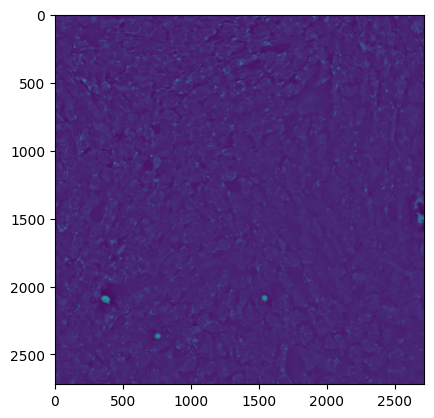

In [20]:
#Repeat the same analysis for Tz images
#flat field correction
Tz_FOV_1_G3BP1_FF = filters.difference_of_gaussians(Tz_FOV_1[0],1,sigma_FF)
Tz_FOV_2_G3BP1_FF = filters.difference_of_gaussians(Tz_FOV_2[0],1,sigma_FF)
Tz_FOV_3_G3BP1_FF = filters.difference_of_gaussians(Tz_FOV_3[0],1,sigma_FF)

plt.imshow(Tz_FOV_1_G3BP1_FF)

In [21]:
#continue processing

#normalize masked data
Tz_FOV_1_G3BP1_norm = Tz_FOV_1_G3BP1_FF/np.max(Tz_FOV_1_G3BP1_FF)
Tz_FOV_2_G3BP1_norm = Tz_FOV_2_G3BP1_FF/np.max(Tz_FOV_2_G3BP1_FF)
Tz_FOV_3_G3BP1_norm = Tz_FOV_3_G3BP1_FF/np.max(Tz_FOV_3_G3BP1_FF)

#isolate edges 
Tz_FOV_1_G3BP1_norm_bkgdsub = filters.difference_of_gaussians(Tz_FOV_1_G3BP1_norm, 1, 2)
Tz_FOV_2_G3BP1_norm_bkgdsub = filters.difference_of_gaussians(Tz_FOV_2_G3BP1_norm, 1, 2)
Tz_FOV_3_G3BP1_norm_bkgdsub = filters.difference_of_gaussians(Tz_FOV_3_G3BP1_norm, 1, 2)

#binarize image 
Tz_FOV_1_G3BP1_bin = Tz_FOV_1_G3BP1_norm_bkgdsub > threshold_val
Tz_FOV_2_G3BP1_bin = Tz_FOV_2_G3BP1_norm_bkgdsub > threshold_val
Tz_FOV_3_G3BP1_bin = Tz_FOV_3_G3BP1_norm_bkgdsub > threshold_val

#generate contours to assess performance
contours_4 = measure.find_contours(Tz_FOV_1_G3BP1_bin)
contours_5 = measure.find_contours(Tz_FOV_2_G3BP1_bin)
contours_6 = measure.find_contours(Tz_FOV_3_G3BP1_bin)

#filter contours
contours_4_filt =  [x for x in contours_4 if x.size < maxPunctaSize and x.size > minPunctaSize]
contours_5_filt = [x for x in contours_5 if x.size < maxPunctaSize and x.size > minPunctaSize]
contours_6_filt =  [x for x in contours_6 if x.size < maxPunctaSize and x.size > minPunctaSize]


(0.0, 500.0)

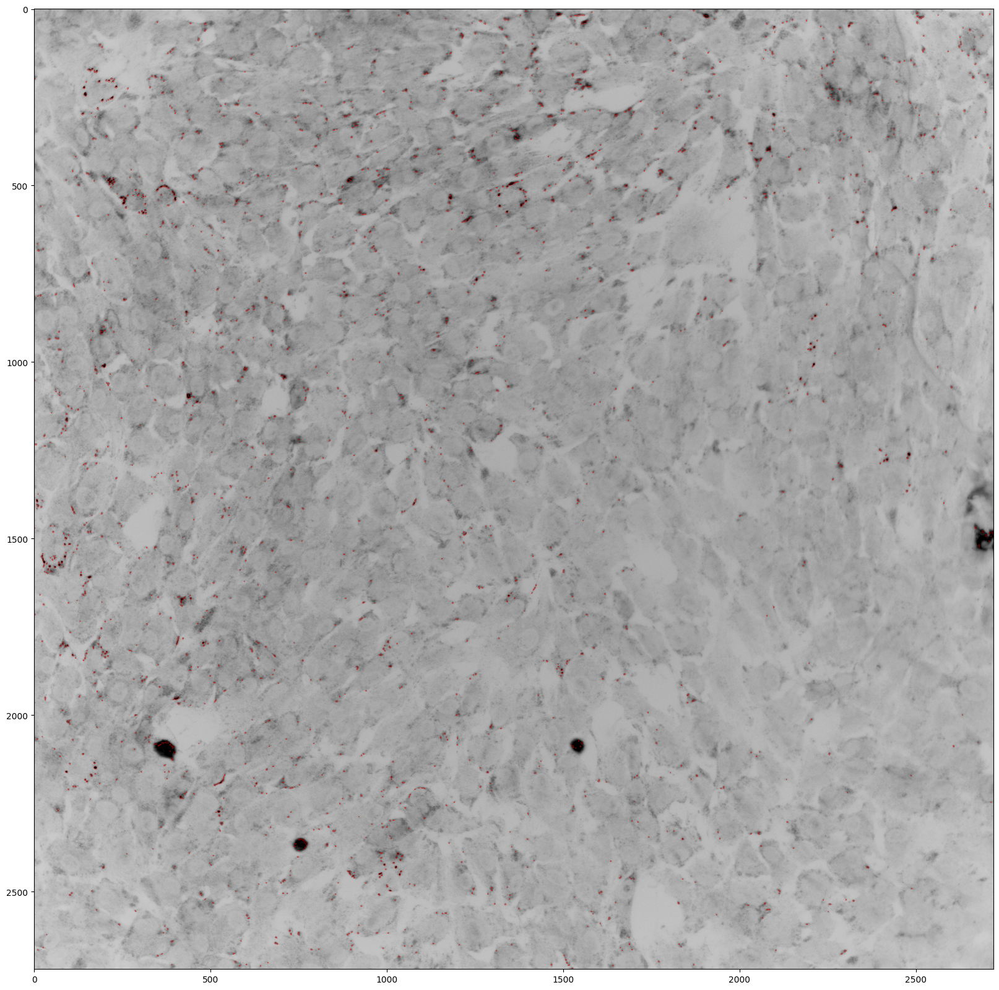

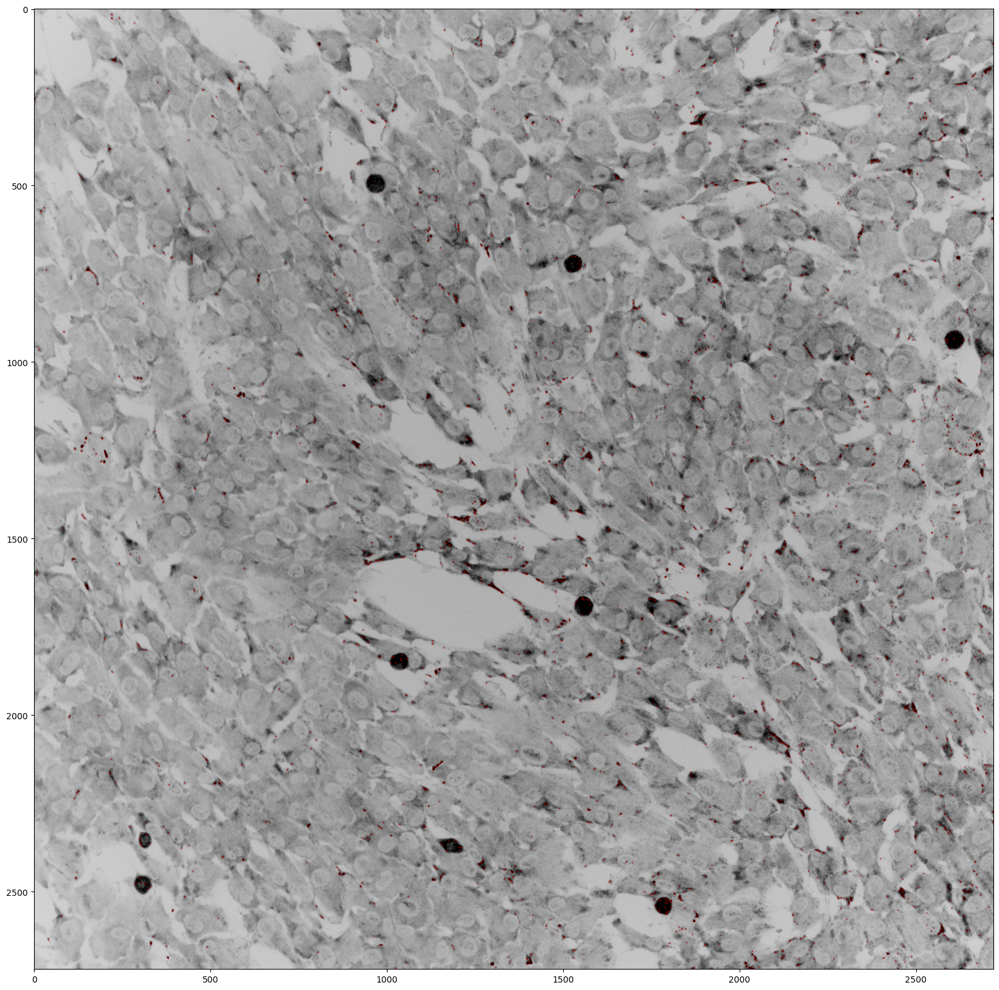

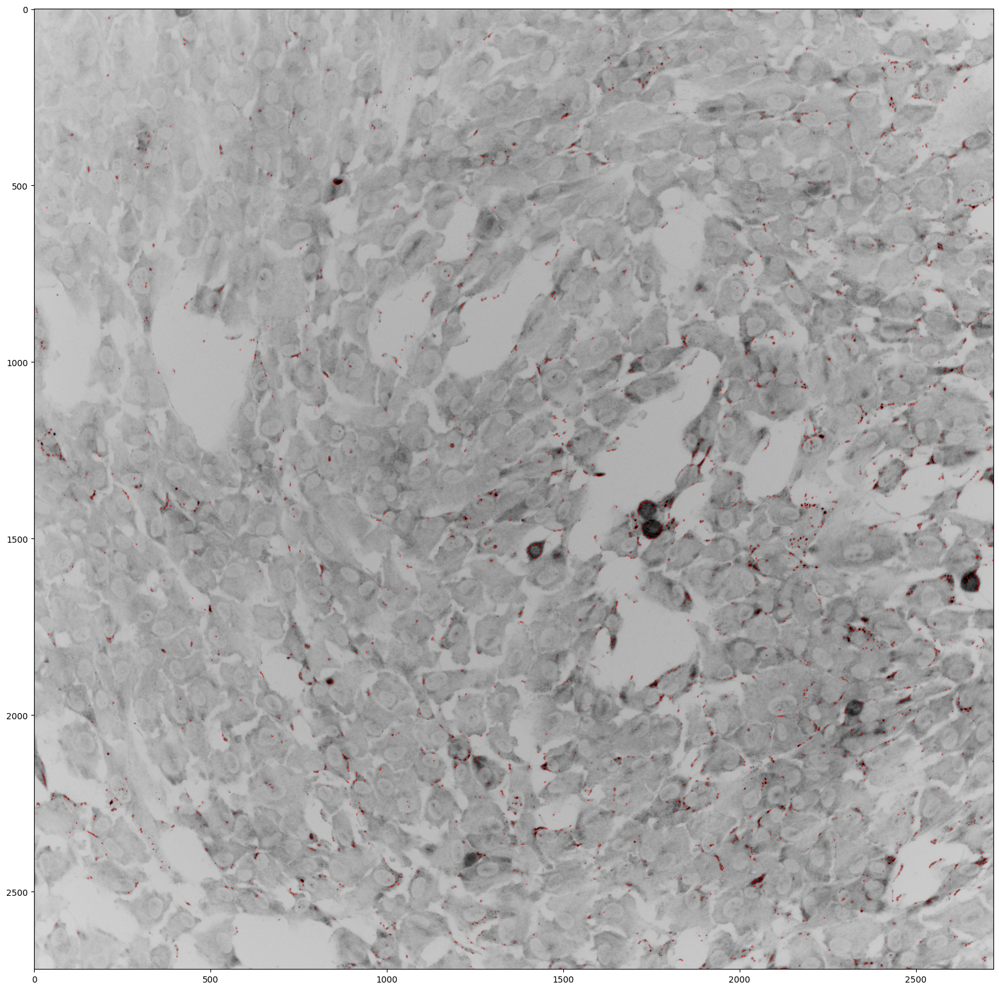

In [22]:
#Check puncta classification in full view images
plt.figure(figsize = (20,30))
plt.imshow(Tz_FOV_1[0], cmap = 'gray_r', clim = [0,15000])
for contour in contours_4_filt:
    plt.gca().plot(contour[:, 1], contour[:, 0], linewidth=0.3, color = 'r')
ax.set_xlim([0,500])
ax.set_ylim([0,500])

plt.figure(figsize = (20,30))
plt.imshow(Tz_FOV_2[0], cmap = 'gray_r', clim = [0,15000])
for contour in contours_5_filt:
    plt.gca().plot(contour[:, 1], contour[:, 0], linewidth=0.3, color = 'r')
ax.set_xlim([0,500])
ax.set_ylim([0,500])

plt.figure(figsize = (20,30))
plt.imshow(Tz_FOV_3[0], cmap = 'gray_r', clim = [0,15000])
for contour in contours_6_filt:
    plt.gca().plot(contour[:, 1], contour[:, 0], linewidth=0.3, color = 'r')
ax.set_xlim([0,500])
ax.set_ylim([0,500])

(300.0, 600.0)

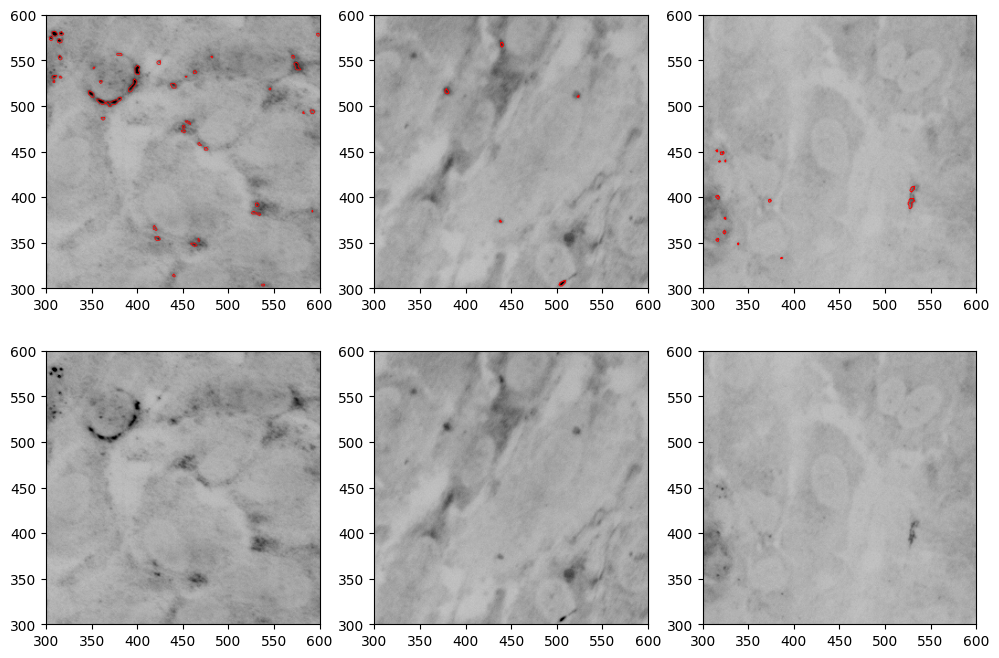

In [23]:
#Check puncta classification in zoomed image
#compare to unlabelled im below
xmin, xmax, ymin, ymax = 300, 600, 300, 600

plt.figure(figsize = (12,8))
ax = plt.subplot(2,3,1)
plt.imshow(Tz_FOV_1[0], cmap = 'gray_r', clim = [0,15000])
for contour in contours_4_filt:
    ax.plot(contour[:, 1], contour[:, 0], linewidth=0.5, color = 'r')
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])

ax = plt.subplot(2,3,2)
plt.imshow(Tz_FOV_2[0], cmap = 'gray_r', clim = [0,15000])
for contour in contours_5_filt:
    ax.plot(contour[:, 1], contour[:, 0], linewidth=0.7, color = 'r')
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])

ax = plt.subplot(2,3,3)
plt.imshow(Tz_FOV_3[0], cmap = 'gray_r', clim = [0,15000])
for contour in contours_6_filt:
    ax.plot(contour[:, 1], contour[:, 0], linewidth=0.7, color = 'r')
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])

ax = plt.subplot(2,3,4)
plt.imshow(Tz_FOV_1[0], cmap = 'gray_r', clim = [0,15000])
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])

ax = plt.subplot(2,3,5)
plt.imshow(Tz_FOV_2[0], cmap = 'gray_r', clim = [0,15000])
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])

ax = plt.subplot(2,3,6)
plt.imshow(Tz_FOV_3[0], cmap = 'gray_r', clim = [0,15000])
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])

In [24]:
#How many puncta were in each FOV
print('puncta in FOV1 = ' + str(len(contours_4_filt)))
print('puncta in FOV2 = ' + str(len(contours_5_filt)))
print('puncta in FOV3 = ' + str(len(contours_6_filt)))


puncta in FOV1 = 1770
puncta in FOV2 = 1658
puncta in FOV3 = 2208


nuclei in FOV1 = 683
nuclei in FOV2 = 619
nuclei in FOV3 = 561


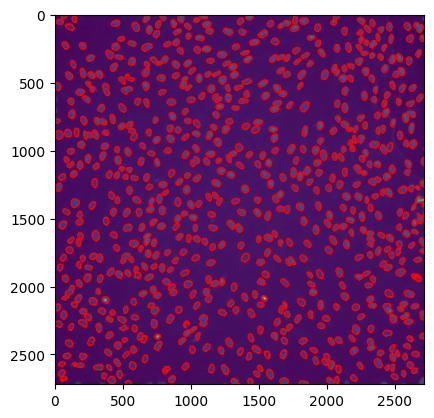

In [25]:
#How many nuclei in each?
#FF correct
Tz_FOV_1_nuc_FF = filters.difference_of_gaussians(Tz_FOV_1[2],1,sigma_FF)
Tz_FOV_2_nuc_FF = filters.difference_of_gaussians(Tz_FOV_2[2],1,sigma_FF)
Tz_FOV_3_nuc_FF = filters.difference_of_gaussians(Tz_FOV_3[2],1,sigma_FF)

#blur nuclear channel for smooth filtering
Tz_FOV_1_nuc = filters.gaussian(Tz_FOV_1_nuc_FF, sigma)
Tz_FOV_2_nuc = filters.gaussian(Tz_FOV_2_nuc_FF, sigma)
Tz_FOV_3_nuc = filters.gaussian(Tz_FOV_3_nuc_FF, sigma)

#take values above threshold
Tz_FOV_1_nuc_mask = Tz_FOV_1_nuc > 0.8*filters.threshold_otsu(Tz_FOV_1_nuc)
Tz_FOV_2_nuc_mask = Tz_FOV_2_nuc > 0.8*filters.threshold_otsu(Tz_FOV_2_nuc)
Tz_FOV_3_nuc_mask = Tz_FOV_3_nuc > 0.8*filters.threshold_otsu(Tz_FOV_3_nuc)

#plot example
contours_nuc_4 = measure.find_contours(Tz_FOV_1_nuc_mask)
contours_nuc_4_filt = [x for x in contours_nuc_4 if x.size < nucmax and x.size > nucmin]

plt.imshow(Tz_FOV_1[2])
for contour in contours_nuc_4_filt:
    plt.gca().plot(contour[:, 1], contour[:, 0], linewidth=1, color = 'r')
print('nuclei in FOV1 = ' + str(len(contours_nuc_4_filt)))


#just print value for other FOVs
contours_nuc_5 = measure.find_contours(Tz_FOV_2_nuc_mask)
contours_nuc_5_filt = [x for x in contours_nuc_5 if x.size < nucmax and x.size > nucmin]
print('nuclei in FOV2 = ' + str(len(contours_nuc_5_filt)))

contours_nuc_6 = measure.find_contours(Tz_FOV_3_nuc_mask)
contours_nuc_6_filt = [x for x in contours_nuc_6 if x.size < nucmax and x.size > nucmin]
print('nuclei in FOV3 = ' + str(len(contours_nuc_6_filt)))

In [26]:
#Repeat the same analysis for TzNC images
#flat field correction
TzNC_FOV_1_G3BP1_FF = filters.difference_of_gaussians(TzNC_FOV_1[0],1,sigma_FF)
TzNC_FOV_2_G3BP1_FF = filters.difference_of_gaussians(TzNC_FOV_2[0],1,sigma_FF)
TzNC_FOV_3_G3BP1_FF = filters.difference_of_gaussians(TzNC_FOV_3[0],1,sigma_FF)

In [27]:
#Let's repeat normalization, background subtraction, and binarization as above for Tz dataset
TzNC_FOV_1_G3BP1_norm = TzNC_FOV_1_G3BP1_FF/np.max(TzNC_FOV_1_G3BP1_FF)
TzNC_FOV_2_G3BP1_norm = TzNC_FOV_2_G3BP1_FF/np.max(TzNC_FOV_2_G3BP1_FF)
TzNC_FOV_3_G3BP1_norm = TzNC_FOV_3_G3BP1_FF/np.max(TzNC_FOV_3_G3BP1_FF)

TzNC_FOV_1_G3BP1_norm_bkgdsub = filters.difference_of_gaussians(TzNC_FOV_1_G3BP1_norm, 1, 2)
TzNC_FOV_2_G3BP1_norm_bkgdsub = filters.difference_of_gaussians(TzNC_FOV_2_G3BP1_norm, 1, 2)
TzNC_FOV_3_G3BP1_norm_bkgdsub = filters.difference_of_gaussians(TzNC_FOV_3_G3BP1_norm, 1, 2)

TzNC_FOV_1_G3BP1_bin = TzNC_FOV_1_G3BP1_norm_bkgdsub > threshold_val
TzNC_FOV_2_G3BP1_bin = TzNC_FOV_2_G3BP1_norm_bkgdsub > threshold_val
TzNC_FOV_3_G3BP1_bin = TzNC_FOV_3_G3BP1_norm_bkgdsub > threshold_val

#Here we repeat our contour generation to check performance
contours_7 = measure.find_contours(TzNC_FOV_1_G3BP1_bin)
contours_8 = measure.find_contours(TzNC_FOV_2_G3BP1_bin)
contours_9 = measure.find_contours(TzNC_FOV_3_G3BP1_bin)

contours_7_filt =  [x for x in contours_7 if x.size < maxPunctaSize and x.size > minPunctaSize]
contours_8_filt = [x for x in contours_8 if x.size < maxPunctaSize and x.size > minPunctaSize]
contours_9_filt =  [x for x in contours_9 if x.size < maxPunctaSize and x.size > minPunctaSize]


(0.0, 500.0)

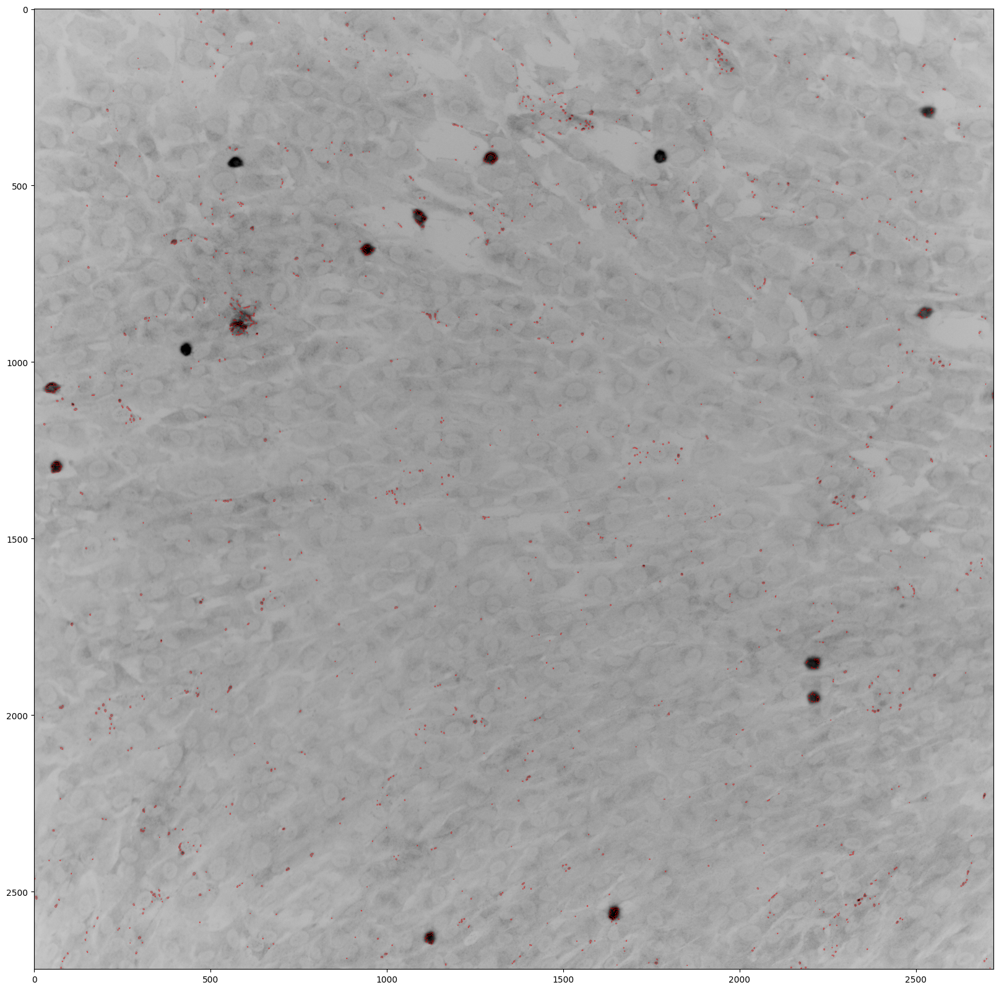

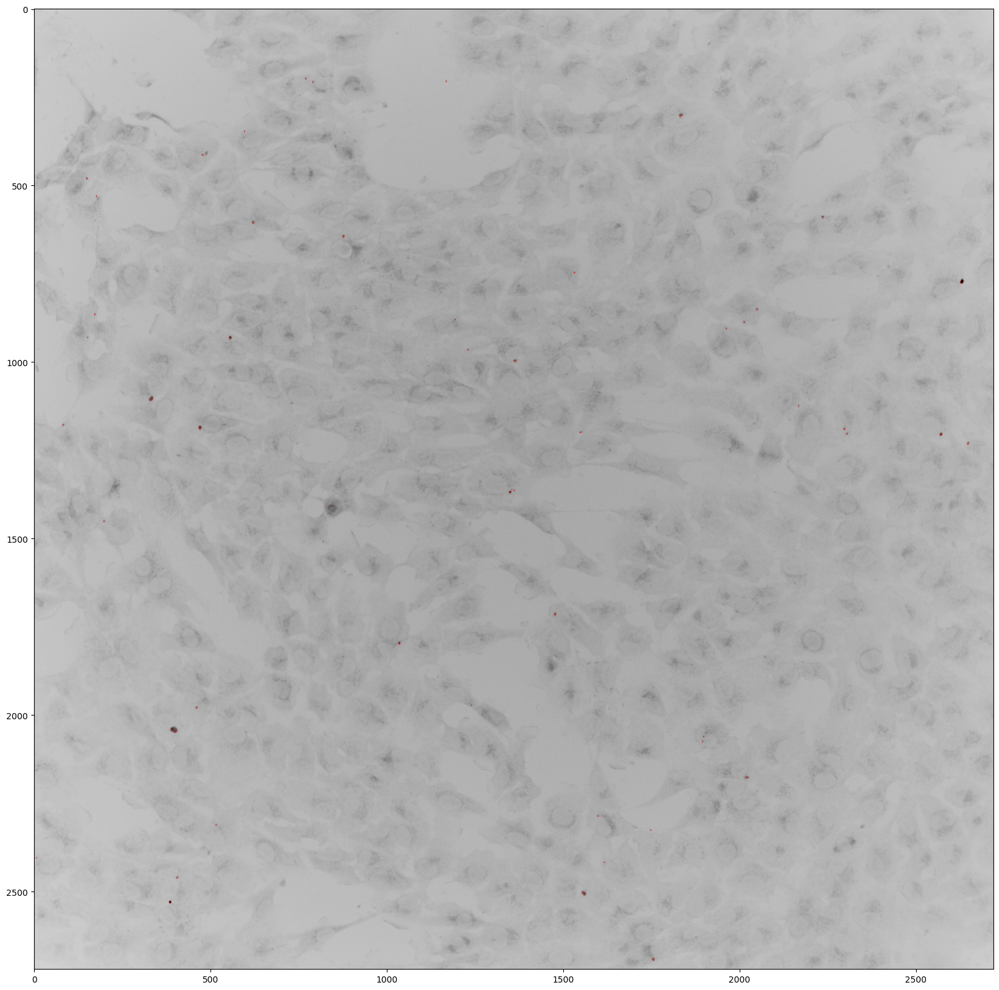

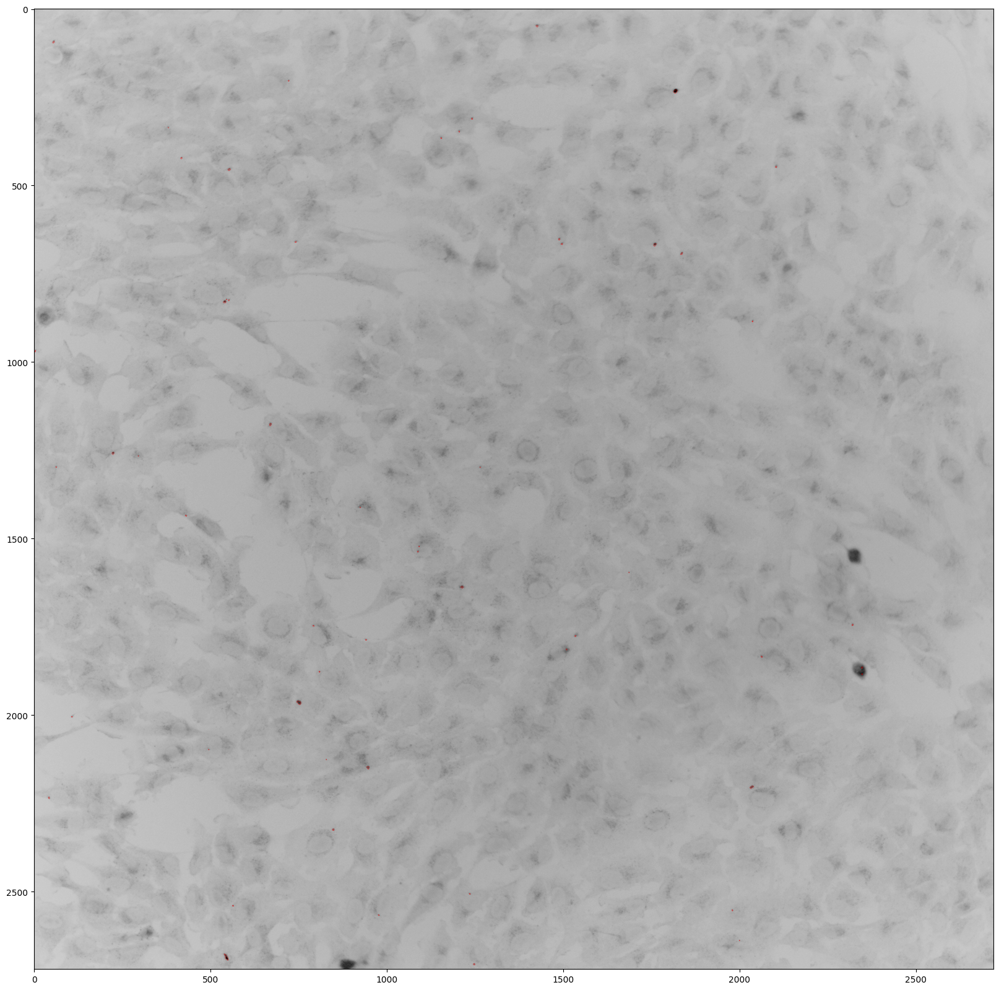

In [28]:
#Large image with contour overlay for FOV1
plt.figure(figsize = (20,30))
plt.imshow(TzNC_FOV_1[0], cmap = 'gray_r', clim = [0,15000])
for contour in contours_7_filt:
    plt.gca().plot(contour[:, 1], contour[:, 0], linewidth=0.3, color = 'r')
ax.set_xlim([0,500])
ax.set_ylim([0,500])

plt.figure(figsize = (20,30))
plt.imshow(TzNC_FOV_2[0], cmap = 'gray_r', clim = [0,15000])
for contour in contours_8_filt:
    plt.gca().plot(contour[:, 1], contour[:, 0], linewidth=0.3, color = 'r')
ax.set_xlim([0,500])
ax.set_ylim([0,500])

plt.figure(figsize = (20,30))
plt.imshow(TzNC_FOV_3[0], cmap = 'gray_r', clim = [0,15000])
for contour in contours_9_filt:
    plt.gca().plot(contour[:, 1], contour[:, 0], linewidth=0.3, color = 'r')
ax.set_xlim([0,500])
ax.set_ylim([0,500])



(200.0, 500.0)

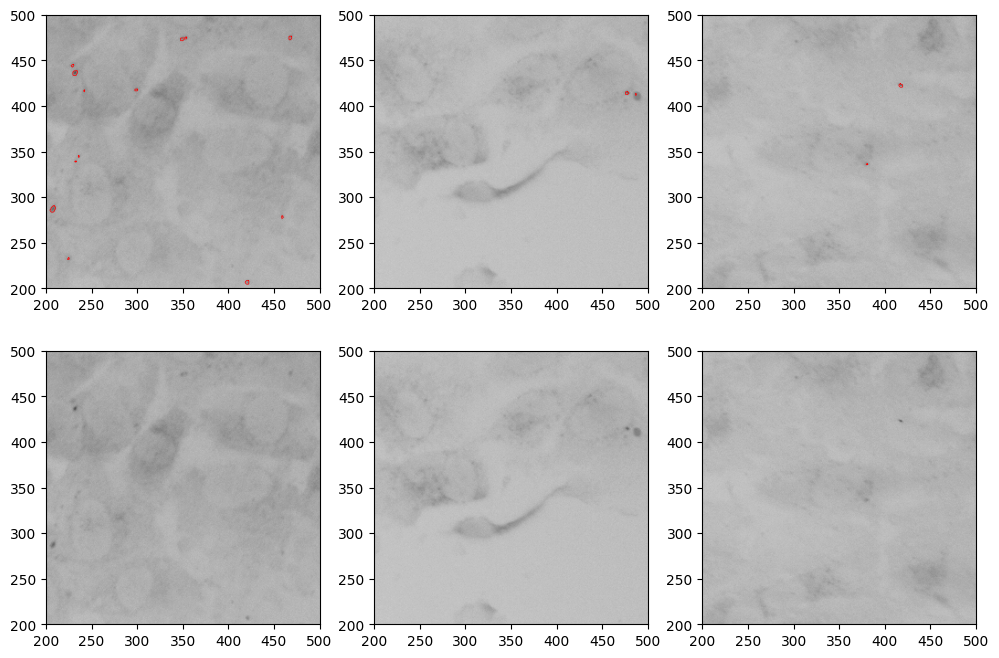

In [29]:
#Here we are plotting zoomed in regions of each G3BP1 channel with overlaid contours
xmin, xmax, ymin, ymax = 200, 500, 200, 500

plt.figure(figsize = (12,8))
ax = plt.subplot(2,3,1)
plt.imshow(TzNC_FOV_1[0], cmap = 'gray_r', clim = [0,15000])
for contour in contours_7_filt:
    ax.plot(contour[:, 1], contour[:, 0], linewidth=0.5, color = 'r')
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])

ax = plt.subplot(2,3,2)
plt.imshow(TzNC_FOV_2[0], cmap = 'gray_r', clim = [0,15000])
for contour in contours_8_filt:
    ax.plot(contour[:, 1], contour[:, 0], linewidth=0.5, color = 'r')
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])

ax = plt.subplot(2,3,3)
plt.imshow(TzNC_FOV_3[0], cmap = 'gray_r', clim = [0,15000])
for contour in contours_9_filt:
    ax.plot(contour[:, 1], contour[:, 0], linewidth=0.5, color = 'r')
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])

ax = plt.subplot(2,3,4)
plt.imshow(TzNC_FOV_1[0], cmap = 'gray_r', clim = [0,15000])
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])

ax = plt.subplot(2,3,5)
plt.imshow(TzNC_FOV_2[0], cmap = 'gray_r', clim = [0,15000])
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])

ax = plt.subplot(2,3,6)
plt.imshow(TzNC_FOV_3[0], cmap = 'gray_r', clim = [0,15000])
ax.set_xlim([xmin,xmax])
ax.set_ylim([ymin,ymax])



In [30]:
#How many puncta?
print('puncta in FOV1 = ' + str(len(contours_7_filt)))
print('puncta in FOV2 = ' + str(len(contours_8_filt)))
print('puncta in FOV3 = ' + str(len(contours_9_filt)))


puncta in FOV1 = 1197
puncta in FOV2 = 56
puncta in FOV3 = 56


nuclei in FOV1 = 851
nuclei in FOV2 = 507
nuclei in FOV3 = 496


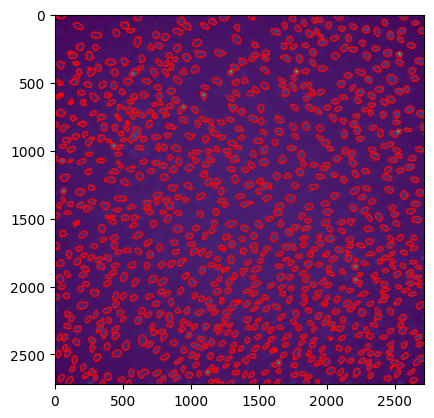

In [31]:
#blur nuclear channel for smooth filtering
sigma = 1
TzNC_FOV_1_nuc_FF = filters.difference_of_gaussians(TzNC_FOV_1[2],1,sigma_FF)
TzNC_FOV_2_nuc_FF = filters.difference_of_gaussians(TzNC_FOV_2[2],1,sigma_FF)
TzNC_FOV_3_nuc_FF = filters.difference_of_gaussians(TzNC_FOV_3[2],1,sigma_FF)


TzNC_FOV_1_nuc = filters.gaussian(TzNC_FOV_1_nuc_FF, sigma)
TzNC_FOV_2_nuc = filters.gaussian(TzNC_FOV_2_nuc_FF, sigma)
TzNC_FOV_3_nuc = filters.gaussian(TzNC_FOV_3_nuc_FF, sigma)

#take values above threshold
TzNC_FOV_1_nuc_mask = TzNC_FOV_1_nuc > 0.8*filters.threshold_otsu(TzNC_FOV_1_nuc)
TzNC_FOV_2_nuc_mask = TzNC_FOV_2_nuc > 0.8*filters.threshold_otsu(TzNC_FOV_2_nuc)
TzNC_FOV_3_nuc_mask = TzNC_FOV_3_nuc > 0.8*filters.threshold_otsu(TzNC_FOV_3_nuc)

#example contours + plotting
contours_nuc_7 = measure.find_contours(TzNC_FOV_1_nuc_mask)
contours_nuc_7_filt = [x for x in contours_nuc_7 if x.size < nucmax and x.size > nucmin]

plt.imshow(TzNC_FOV_1[2])
for contour in contours_nuc_7_filt:
    plt.gca().plot(contour[:, 1], contour[:, 0], linewidth=1, color = 'r')
print('nuclei in FOV1 = ' + str(len(contours_nuc_7_filt)))

#just print value for other FOVs
contours_nuc_8 = measure.find_contours(TzNC_FOV_2_nuc_mask)
contours_nuc_8_filt = [x for x in contours_nuc_8 if x.size < nucmax and x.size > nucmin]
print('nuclei in FOV2 = ' + str(len(contours_nuc_8_filt)))

contours_nuc_9 = measure.find_contours(TzNC_FOV_3_nuc_mask)
contours_nuc_9_filt = [x for x in contours_nuc_9 if x.size < nucmax and x.size > nucmin]
print('nuclei in FOV3 = ' + str(len(contours_nuc_9_filt)))

In [32]:
#dimness of Tz N2C makes images largely unusable. Pos1 might be okay but not clear...

In [37]:
#put usable data into a plottable dataframe
nodrug_df = pd.DataFrame({'condition': ['no drug', 'no drug', 'no drug'], 'FOV':[1,2,3], 
              'nuclei':[len(contours_nuc_1_filt), len(contours_nuc_2_filt), len(contours_nuc_3_filt)], 
             'puncta': [len(contours_1_filt), len(contours_2_filt), len(contours_3_filt)]})

Tz_df = pd.DataFrame({'condition': ['Tz', 'Tz', 'Tz'], 'FOV':[1,2,3], 
              'nuclei':[len(contours_nuc_4_filt), len(contours_nuc_5_filt), len(contours_nuc_6_filt)], 
             'puncta': [len(contours_4_filt), len(contours_5_filt), len(contours_6_filt)]})

TzN2C_df = pd.DataFrame({'condition': ['Tz-N2C', 'Tz-N2C', 'Tz-N2C'], 'FOV':[1, 2, 3], 
              'nuclei':[len(contours_nuc_7_filt), len(contours_nuc_8_filt), len(contours_nuc_9_filt)], 
             'puncta': [len(contours_7_filt), len(contours_8_filt), len(contours_9_filt)]})

df_total = pd.concat([nodrug_df, Tz_df, TzN2C_df])

In [38]:
df_total

,condition,FOV,nuclei,puncta
0,no drug,1,724,3802
1,no drug,2,707,4623
2,no drug,3,659,3126
0,Tz,1,683,1770
1,Tz,2,619,1658
2,Tz,3,561,2208
0,Tz-N2C,1,851,1197
1,Tz-N2C,2,507,56
2,Tz-N2C,3,496,56


(0.0, 5000.0)

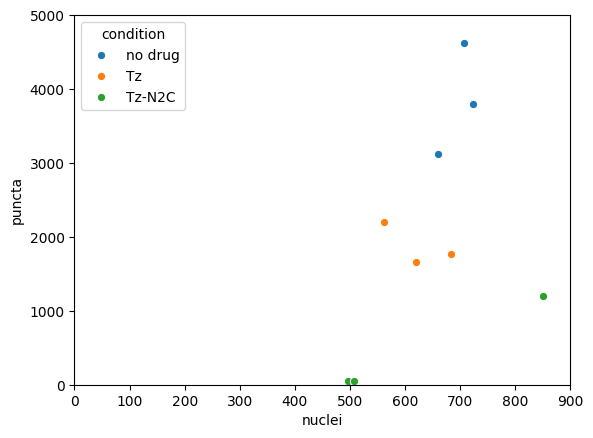

In [39]:
sns.lineplot(x = 'nuclei', y = 'puncta', hue = 'condition', data = df_total, marker = 'o', linewidth = 0)
plt.xlim([0,900])
plt.ylim([0, 5000])

In [36]:
#expectation is there should be more granules as nuclei number increases
#we see in the presence of drug there are less puncta regardless of nucleus number
#fold change is ~0.5x

#FOV2 and 3 for Tz N2C is too dim, hence the low value. I do not think that is real. Values should likely be closer to that of FOV1